In [ ]:
!pip install easyocr

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 35.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 422.9/422.9 kB 33.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 912.2/912.2 kB 60.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 286.8/286.8 kB 26.1 MB/s eta 0:00:00


In [ ]:
!pip install pytesseract
import pytesseract

import pytesseract
# Set the path to the Tesseract executable
pytesseract.pytesseract.tesseract_cmd = r'/usr/bin/tesseract'

In [ ]:
import easyocr
reader = easyocr.Reader(['en'])

Progress: |██████████████████████████████████████████████████| 100.0% Complete

Progress: |██████████████████████████████████████████████████| 100.0% Complete

In [ ]:
import cv2
import numpy as np
import pytesseract
import os
import random
import cv2
from google.colab.patches import cv2_imshow



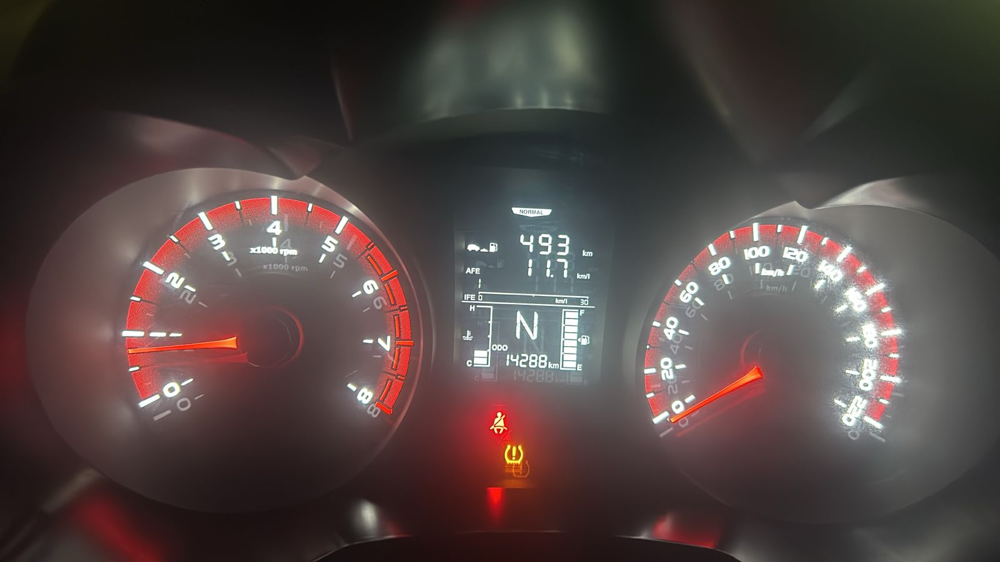

In [ ]:
path_to_main = '/content/drive/MyDrive/Ubiquitous /QueryImages/image.png'
imgQ = cv2.imread(path_to_main)
if imgQ is None:
    print("Error: Image not loaded.")
h, w, c = imgQ.shape
cv2_imshow (imgQ)
cv2.waitKey(0)  # Wait for a key press
cv2.destroyAllWindows()  # Close the image window


In [ ]:
print(h , w , c)

900 1600 3


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


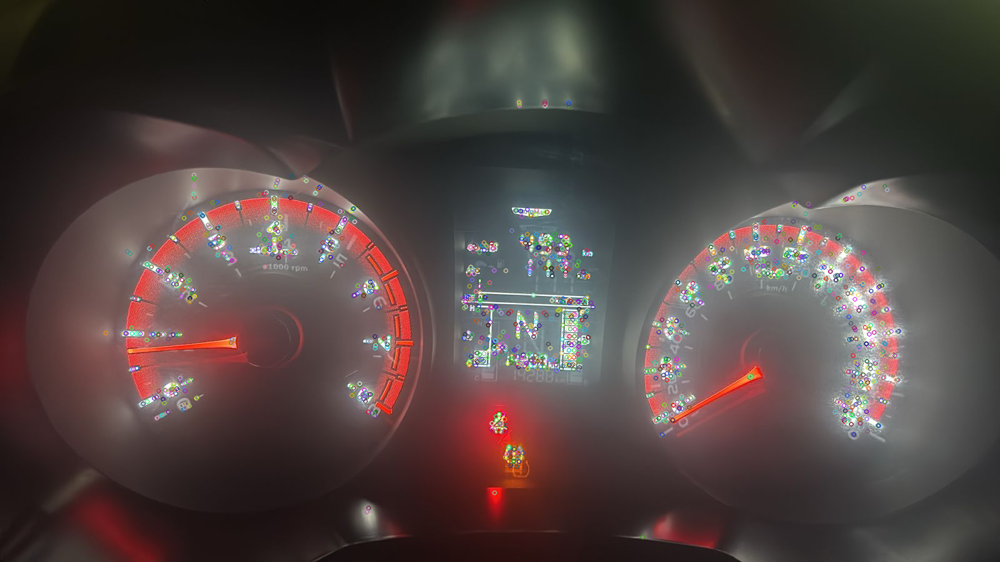

In [ ]:
# Initialize AKAZE detector with reduced maximum keypoints
akaze = cv2.AKAZE_create(threshold=0.001)
kp1, des1 = akaze.detectAndCompute(imgQ, None)
imgKp1 = cv2.drawKeypoints(imgQ, kp1, None)
cv2_imshow( imgKp1)


In [ ]:
print(f"Number of keypoints detected: {len(kp1)}")


Number of keypoints detected: 1580


In [ ]:
path = "/content/drive/MyDrive/Ubiquitous /QueryImages"
myPicList = os.listdir(path)
myPicList.remove(".ipynb_checkpoints")
print(myPicList)

['image.png', 'image copy.png', 'image copy 2.png', 'WhatsApp Image 2024-10-17 at 18.15.32.jpeg', 'WhatsApp Image 2024-10-17 at 18.15.322.jpeg', 'PHOTO-2024-10-18-20-18-45 2.jpg', 'PHOTO-2024-10-18-20-18-45 3.jpg', 'PHOTO-2024-10-18-20-18-46 2.jpg', 'PHOTO-2024-10-18-20-18-46.jpg', 'PHOTO-2024-10-18-20-18-45.jpg', 'PHOTO-2024-10-18-20-18-47.jpg']


In [ ]:
def display_resized_images(path, myPicList, target_width=500):
    images_per_row = 2
    images = []

    for j, y in enumerate(myPicList):
        img = cv2.imread(os.path.join(path, y))
        if img is None:
            print(f"Error reading image {y}")
            continue

        # Calculate the target height to maintain aspect ratio
        height, width = img.shape[:2]
        aspect_ratio = height / width
        target_height = int(target_width * aspect_ratio)

        # Resize the image
        resized_img = cv2.resize(img, (target_width, target_height))
        images.append(resized_img)

    # Create a blank canvas to hold the images
    rows = (len(images) + images_per_row - 1) // images_per_row
    canvas_height = max(img.shape[0] for img in images) * rows
    canvas_width = target_width * images_per_row

    canvas = np.zeros((canvas_height, canvas_width, 3), dtype=np.uint8)

    for i, img in enumerate(images):
        row = i // images_per_row
        col = i % images_per_row
        y_offset = row * max(img.shape[0] for img in images)
        x_offset = col * target_width
        canvas[y_offset:y_offset+img.shape[0], x_offset:x_offset+img.shape[1]] = img
        # Display the canvas
    cv2_imshow(canvas)

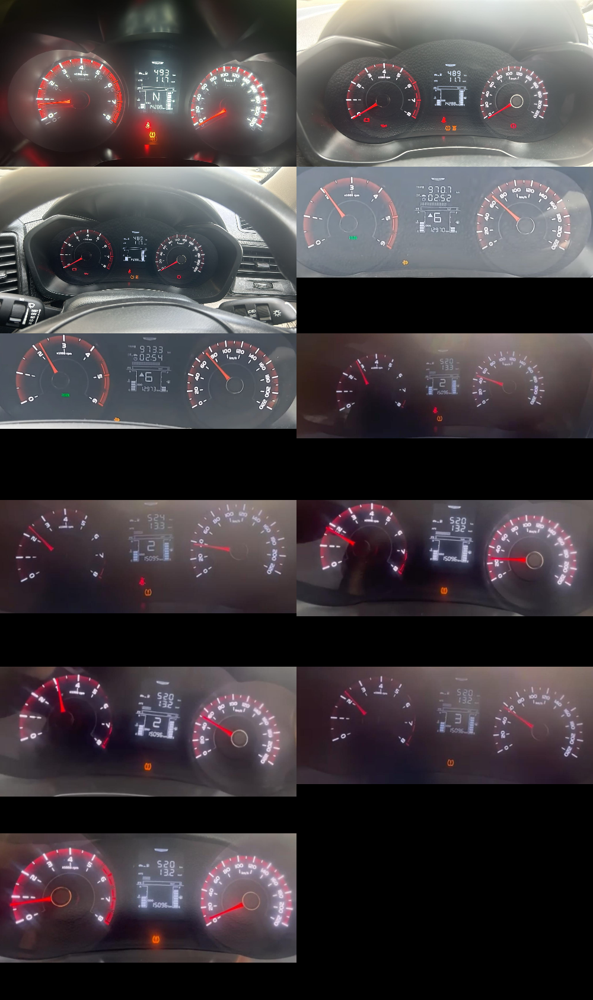

In [ ]:
display_resized_images(path, myPicList)


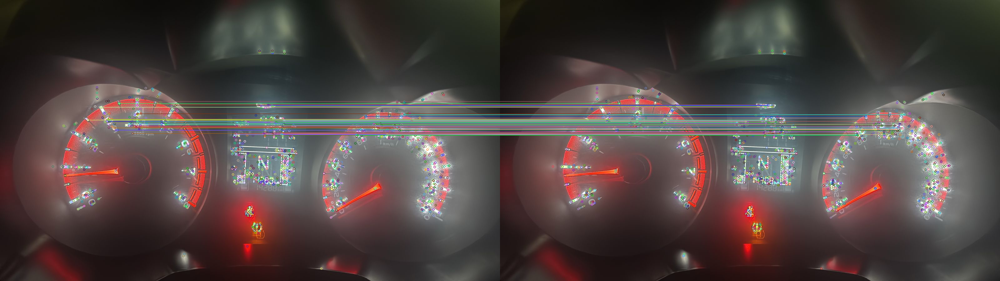

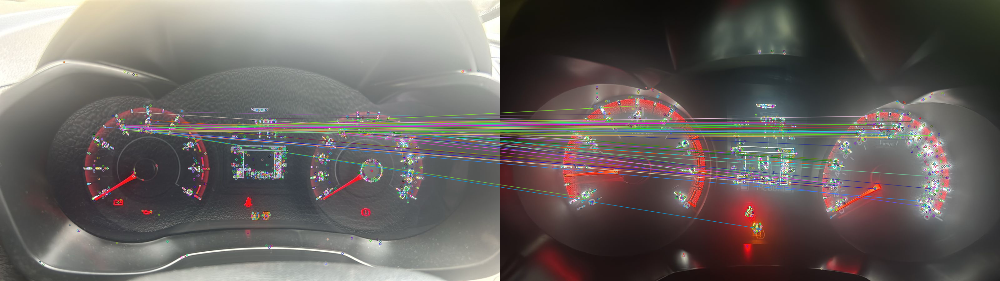

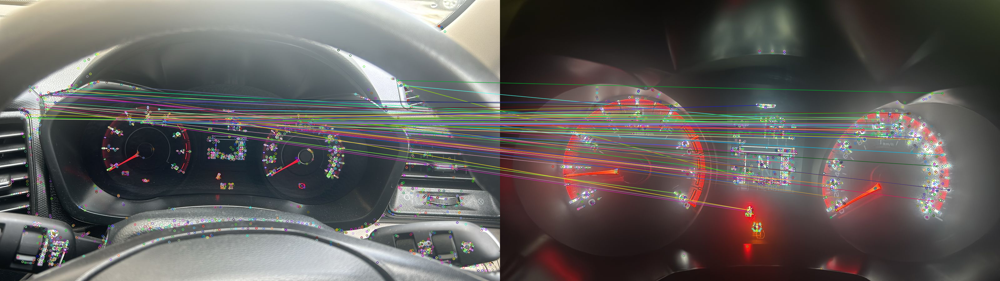

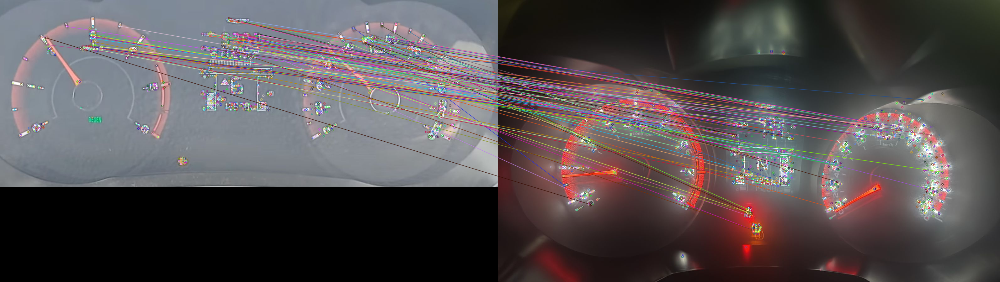

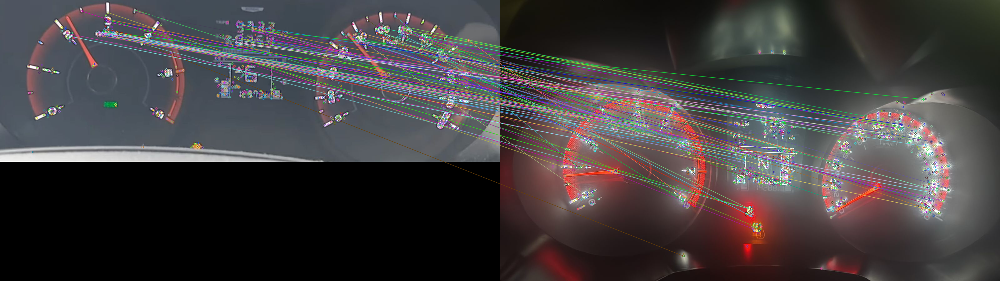

...

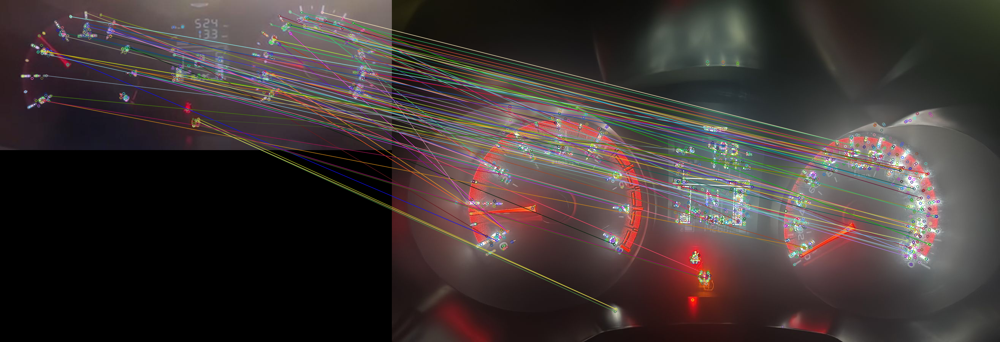

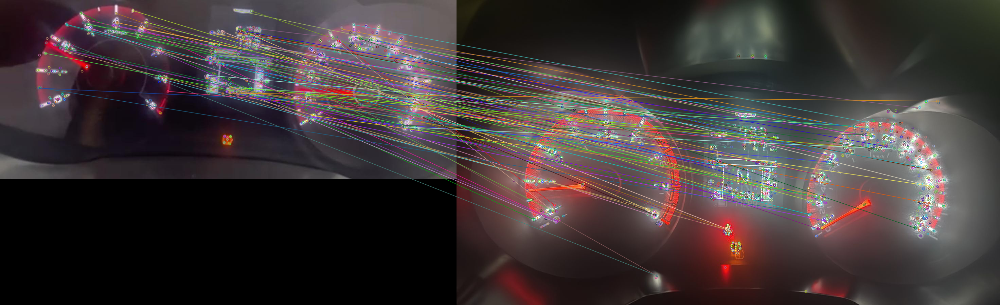

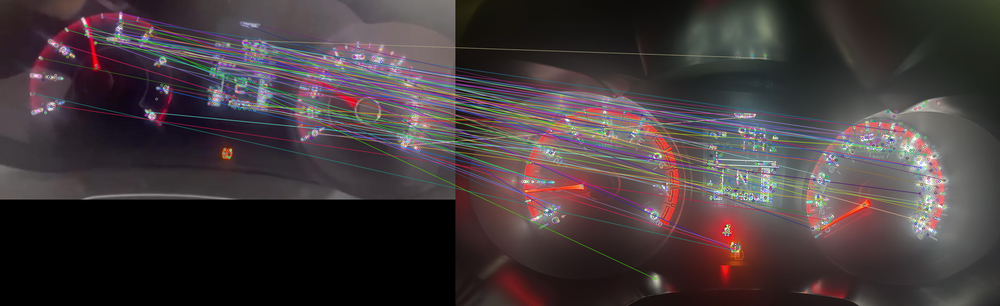

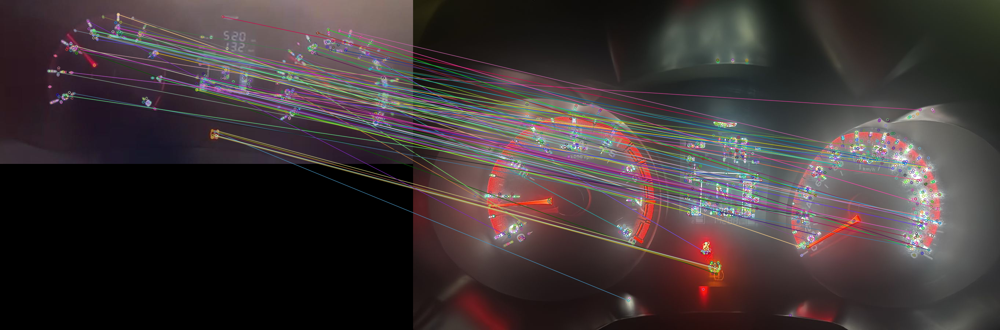

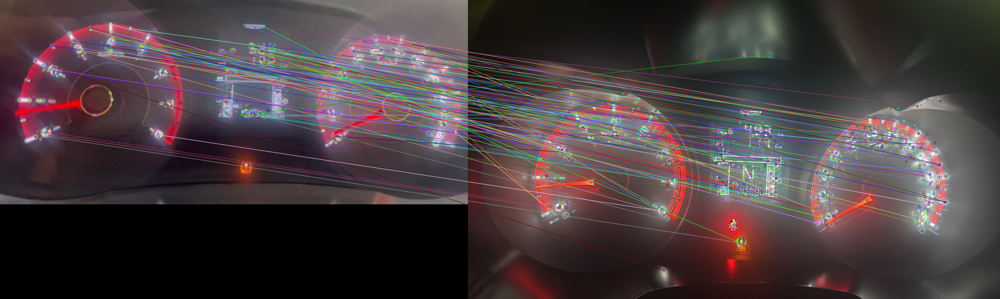

In [ ]:
per = 25 #####################  // percentage bata rha  hai ki homographic matrix se top 25% jo features waali image match ho unhe hi lo
pixelThreshold = 250

for j, y in enumerate(myPicList):
    img = cv2.imread(path + "/" + y)
    kp2, des2 = akaze.detectAndCompute(img, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches = bf.match(des2, des1)
    # matches.sort(key=lambda x: x.distance)
    good = matches[:int(len(matches)*(per/100))]
    imgMatch = cv2.drawMatches(img, kp2, imgQ, kp1, good[:100], None)
    cv2.resize(imgMatch, (w//5, h//5))
    cv2_imshow(imgMatch)
    # cv2.waitKey(0)

In [ ]:
for j, y in enumerate(myPicList):
    img = cv2.imread(path + "/" + y)

    kp2, des2 = akaze.detectAndCompute(img, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches = bf.match(des2, des1)
    # matches.sort(key=lambda x: x.distance)
    good = matches[:int(len(matches)*(per/100))]
    imgMatch = cv2.drawMatches(img, kp2, imgQ, kp1, good[:100], None)
    # cv2.resize(imgMatch, (w//5, h//5))
    # cv2.imshow("Test 4 Matched image", imgMatch)
    # cv2.waitKey(0)
    srcPoints = np.float32(
        [kp2[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
    dstPoints = np.float32(
        [kp1[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

    M, _ = cv2.findHomography(srcPoints, dstPoints, cv2.RANSAC, 5.0)
    imgScan = cv2.warpPerspective(img, M, (w, h))
    # cv2_imshow(imgScan)
    # print(imgScan.shape)
    # cv2.waitKey(0)

In [ ]:
import matplotlib.pyplot as plt
import math

In [ ]:
def map_angle_to_speed(angle):
    min_angle = -30
    max_angle = 210
    min_speed = 0
    max_speed = 220

    if angle < min_angle:
        angle = min_angle
    elif angle > max_angle:
        angle = max_angle

    speed = ((angle - min_angle) / (max_angle - min_angle)) * (max_speed - min_speed) + min_speed
    return speed

In [ ]:
def detect_angle_speedo_and_rpm(path, rpm_or_speed):
  image = path
  print(" image recieved in the function " , cv2_imshow(image) )
  gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
  gray_blurred = cv2.GaussianBlur(gray_image, (5, 5), 0)
  # brightness_value = 50
  # bright_image = cv2.convertScaleAbs(gray_image, alpha=1, beta=brightness_value)
  # _, thresholded_image = cv2.threshold(bright_image, 254, 255, cv2.THRESH_BINARY)
  # cv2_imshow(thresholded_image)
  edges = cv2.Canny(gray_blurred, 50, 150, apertureSize=3)
  # print (edges)
  lines = cv2.HoughLinesP(edges, 1, np.pi / 180,threshold=80, minLineLength=101, maxLineGap=10)
  # print(" lines " , lines)


  max_length = 150
  best_line = None

  # if lines is not None:
  #     for rho, theta in lines[:, 0]:

  #         a = np.cos(theta)
  #         b = np.sin(theta)
  #         x0 = a * rho
  #         y0 = b * rho
  #         x1 = int(x0 + 1000 * (-b))
  #         y1 = int(y0 + 1000 * (a))
  #         x2 = int(x0 - 1000 * (-b))
  #         y2 = int(y0 - 1000 * (a))


  #         cv2.line(image, (x1, y1), (x2, y2), (0, 255, 0), 2)


  #         length = np.sqrt((x2 - x1)**2 + (y2 - y1)**2)
  #         #  yaha par length edit kia hai
  #         if length > max_length:
  #             max_length = length
  #             best_line = (rho, theta)
  if lines is not None:
    max_line_length = 150
    for line in lines:
        x1, y1, x2, y2 = line[0]
        line_length = np.sqrt((x2 - x1) ** 2 + (y2 - y1) ** 2)

        if line_length <= max_line_length:
            cv2.line(image, (x1, y1), (x2, y2), (0, 255, 0), 2)
            dx = x2 - x1
            dy = y2 - y1
            angle_radians = math.atan2(dy, dx)
            angle_degrees = math.degrees(angle_radians)
            print(f"Line: ({x1}, {y1}) -> ({x2}, {y2}), Length: {line_length:.2f}, Angle: {angle_degrees:.2f} degrees")
            print("Current speed:", map_angle_to_speed(angle_degrees))
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
    plt.title("Detected Lines")
    plt.axis("off")
    # plt.savefig("/content/drive/MyDrive/ubi_img/speed.png", bbox_inches='tight', pad_inches=0)
    plt.show()
  else:
    print("No lines were detected.")


  # if best_line:
  #     _, theta = best_line
  #     angle = (theta * 180 / np.pi) - 90
  #     if angle < -20:
  #       angle = -20
  #     # print(f"The angle of the speedometer needle is {angle:.2f} degrees from the horizontal.")
  #     if rpm_or_speed == "speed":
  #       print(f"The speed of the speedometer is {angle + 20:.2f} kmph")
  #     else:
  #       print(f"The RPM of the engine is {(angle  + 22)/27.68 :.2f} X 1000 RPM")
  #     cv2_imshow( image)
  # else:
  #   alt_speed_rpm(path, rpm_or_speed)






def alt_speed_rpm(path, speed):
  # Load the image in grayscale

  image = path
  image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

  brightness_value = 15
  bright_image = cv2.convertScaleAbs(image, alpha=1, beta=brightness_value)
  _, thresholded_image = cv2.threshold(bright_image, 254, 255, cv2.THRESH_BINARY)


  # Check if the image was loaded correctly
  if image is None:
      raise ValueError("Image not loaded. Check the file path.")

  # Apply adaptive thresholding to highlight the needle
  thresh = thresholded_image
  # cv2_imshow(thresh)

  # Find contours
  contours, _ = cv2.findContours(thresh, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

  # Filter contours and find the needle contour (assuming it's the largest)
  needle_contour = max(contours, key=cv2.contourArea)

  # Fit a line to the needle contour
  [vx, vy, x, y] = cv2.fitLine(needle_contour, cv2.DIST_L2, 0, 0.01, 0.01)
  vx, vy, x, y = vx.item(), vy.item(), x.item(), y.item()  # Extract scalar values

  angle_radians = np.arctan2(vy, vx)
  angle_degrees = np.degrees(angle_radians)

  # Print the angle
  if speed == "speed":
    print(f"The speed of the speedometer is {angle_degrees + 20:.2f} kmph")
  else:
    print(f"The RPM of the engine is {(angle_degrees  + 22)/27.68 :.2f} X 1000 RPM")


  # Optional: Draw the line for visualization
  rows, cols = image.shape
  lefty = int((-x * vy / vx) + y)
  righty = int(((cols - x) * vy / vx) + y)
  result_image = cv2.cvtColor(image, cv2.COLOR_GRAY2BGR)
  cv2.line(result_image, (cols - 1, righty), (0, lefty), (0, 255, 0), 2)
  # cv2_imshow(result_image)


Extracting data from Test Image 0
 printing the roi image 
493
 printing the roi image 

 printing the roi image 


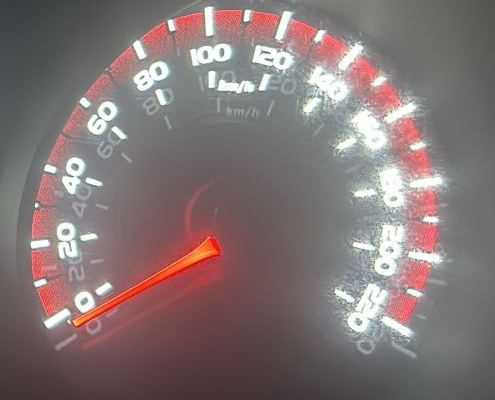

 image recieved in the function  None
Line: (87, 318) -> (190, 263), Length: 116.76, Angle: -28.10 degrees
Current speed: 1.74042796953504


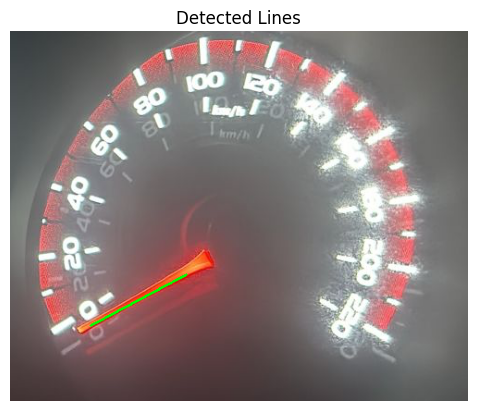

Extracting data from Test Image 1
 printing the roi image 
489
 printing the roi image 

 printing the roi image 


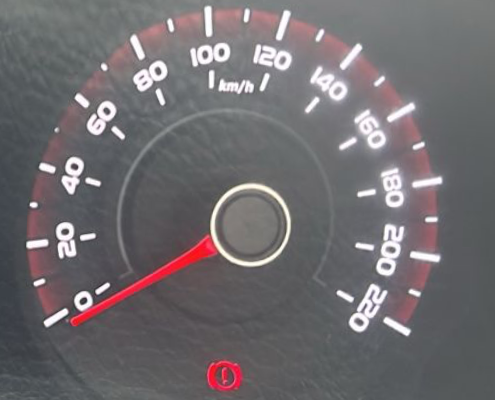

 image recieved in the function  None
No lines were detected.
Extracting data from Test Image 2
 printing the roi image 
489
 printing the roi image 
I{7
 printing the roi image 


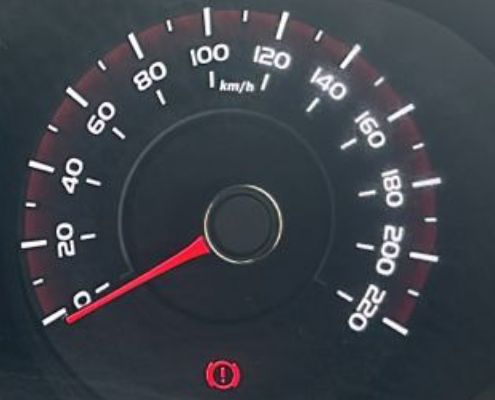

 image recieved in the function  None
Line: (89, 306) -> (208, 235), Length: 138.57, Angle: -30.82 degrees
Current speed: 0.0
Line: (85, 313) -> (189, 258), Length: 117.65, Angle: -27.87 degrees
Current speed: 1.9507101841302774


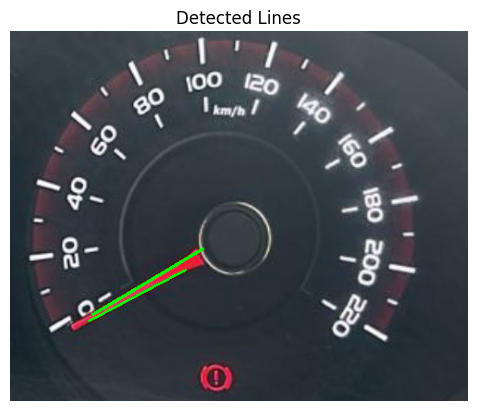

Extracting data from Test Image 3
 printing the roi image 
978.7
 printing the roi image 
252
 printing the roi image 


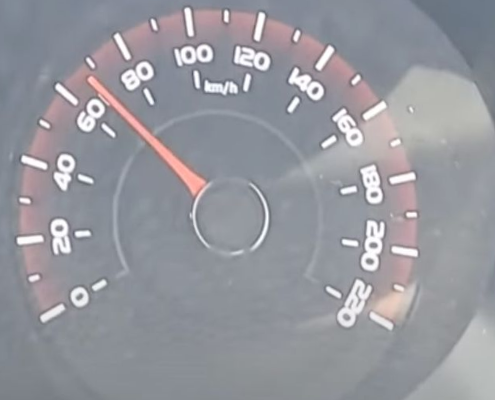

 image recieved in the function  None
No lines were detected.
Extracting data from Test Image 4
 printing the roi image 
9733
 printing the roi image 
2,54
 printing the roi image 


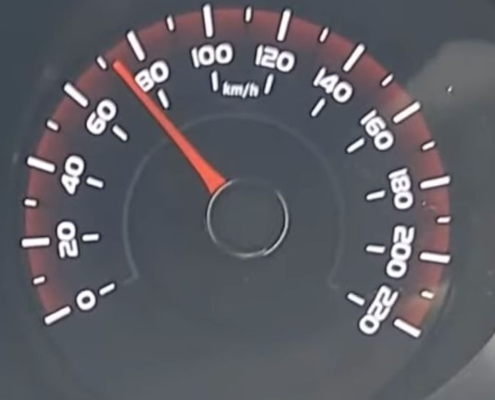

 image recieved in the function  None
Line: (113, 65) -> (200, 173), Length: 138.68, Angle: 51.15 degrees
Current speed: 74.38440685467612


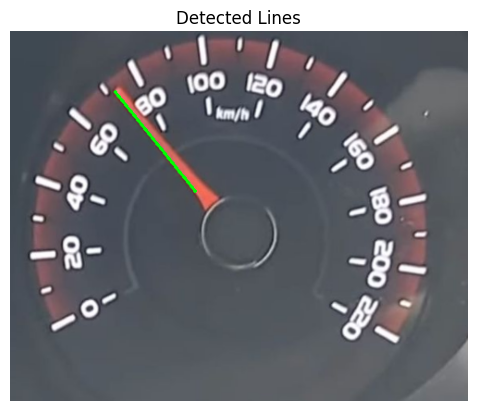

Extracting data from Test Image 5
 printing the roi image 
520
 printing the roi image 
133
 printing the roi image 


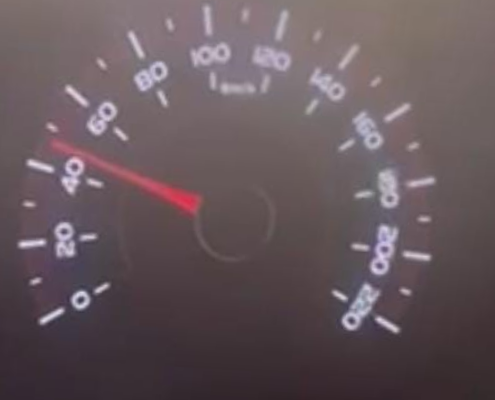

 image recieved in the function  None
No lines were detected.
Extracting data from Test Image 6
 printing the roi image 
524
 printing the roi image 
033
 printing the roi image 


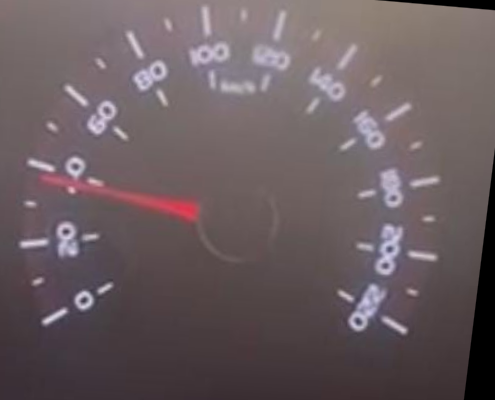

 image recieved in the function  None


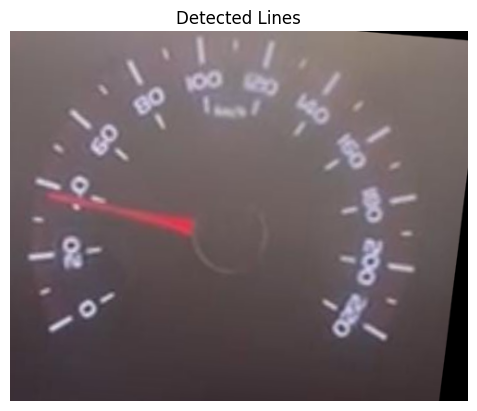

Extracting data from Test Image 7
 printing the roi image 
520
 printing the roi image 
132
 printing the roi image 


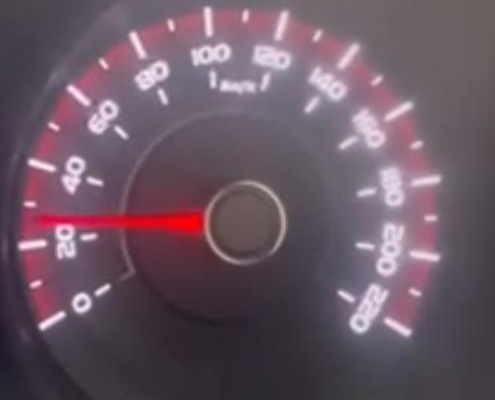

 image recieved in the function  None
No lines were detected.
Extracting data from Test Image 8
 printing the roi image 
520
 printing the roi image 
'3e
 printing the roi image 


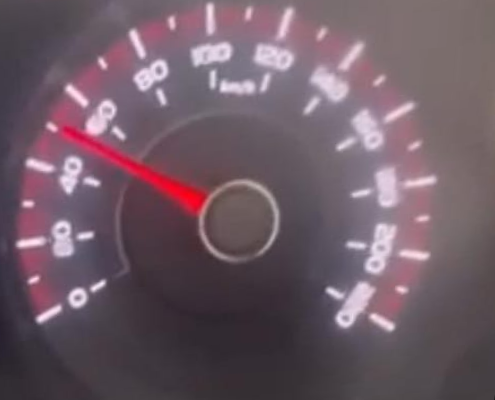

 image recieved in the function  None
No lines were detected.
Extracting data from Test Image 9
 printing the roi image 
520
 printing the roi image 
132
 printing the roi image 


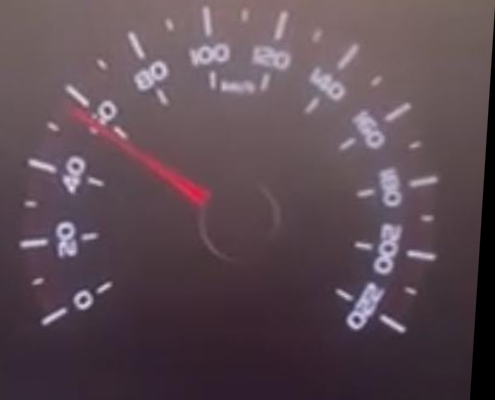

 image recieved in the function  None


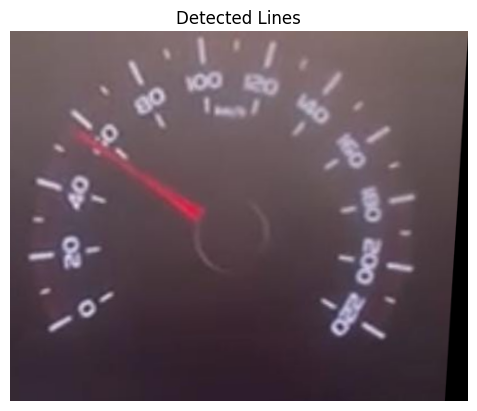

Extracting data from Test Image 10
 printing the roi image 
520
 printing the roi image 
132
 printing the roi image 


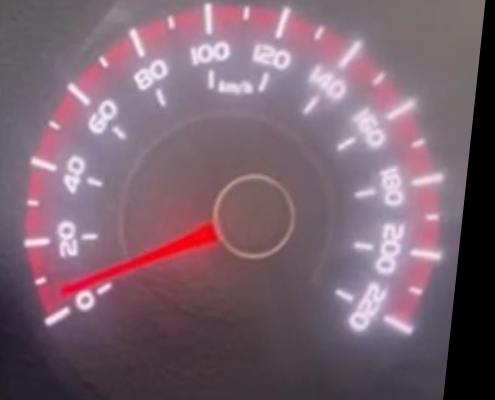

 image recieved in the function  None
Line: (74, 284) -> (186, 236), Length: 121.85, Angle: -23.20 degrees
Current speed: 6.234625362489161


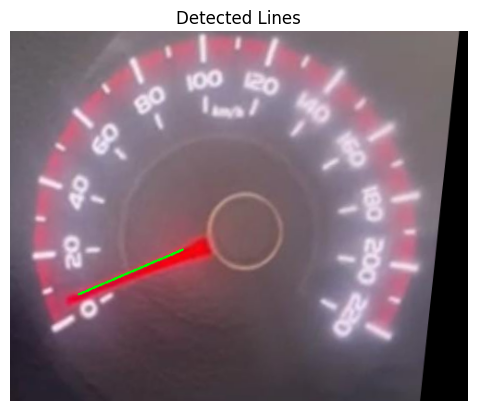

In [ ]:
per = 25 #####################  // percentage bata rha  hai of some type
pixelThreshold = 250
roi = [[(800, 350), (975, 410), 'text', 'Distance Travelled'],
       [(830, 410), (920, 450), 'text', 'Average fuel Economy'] ,
        [(1000 , 350) , (1495,750), 'Dial', 'Speedometer'] ]

for j, y in enumerate(myPicList):
    img = cv2.imread(path + "/" + y)
    # cv2_imshow(img)


    if img is None:
        raise ValueError(f"Error reading image {j}")
    if imgQ is None:
        raise ValueError(f"Error reading image {j}")

    ######################################################

    # gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    # brightness_value = 50
    # bright_image = cv2.convertScaleAbs(gray_image, alpha=1, beta=brightness_value)
    # _, img = cv2.threshold(bright_image, 254, 255, cv2.THRESH_BINARY)

    #####################################

    kp2, des2 = akaze.detectAndCompute(img, None)
    bf = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches = bf.match(des2, des1)
    # matches.sort(key=lambda x: x.distance)
    good = matches[:int(len(matches)*(per/100))]
    imgMatch = cv2.drawMatches(img, kp2, imgQ, kp1, good[:100], None)
    # cv2.resize(imgMatch, (w//5, h//5))
    # cv2.imshow("Test 4 Matched image", imgMatch)
    # cv2.waitKey(0)
    srcPoints = np.float32(
        [kp2[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
    dstPoints = np.float32(
        [kp1[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

    M, _ = cv2.findHomography(srcPoints, dstPoints, cv2.RANSAC, 5.0)
    imgScan = cv2.warpPerspective(img, M, (w, h))
    # cv2.imshow(y, imgScan)
    # cv2.waitKey(0)
    imgShow = imgScan.copy()
    imgMask = np.zeros_like(imgShow)


    ##
    print(f'Extracting data from Test Image {j}')
    for x, r in enumerate(roi):

        cv2.rectangle(imgMask, (r[0][0], r[0][1]),
                      (r[1][0], r[1][1]), (0, 255, 0), cv2.FILLED)
        imgShow = cv2.addWeighted(imgShow, 0.99, imgMask, 0.1, 0)

        imgCrop = imgScan[r[0][1]:r[1][1], r[0][0]:r[1][0]]
        print(" printing the roi image ")
        # cv2_imshow(imgCrop)

        # cv2.waitKey(0)
        if r[2] == 'text':
            #pytesseract Implementation
            # print(f'{r[3]} : {pytesseract.image_to_string(imgCrop)}')
            # myData.append(pytesseract.image_to_string(imgCrop))
            #EasyOcr
            results = reader.readtext(imgCrop)
            extracted_text = " ".join([result[1] for result in results])
            print(extracted_text)
            # print(f'{r[3]} : {pytesseract.image_to_string(imgCrop)}')
        if r[2] == 'Dial':
           if r[3] == 'Speedometer':
            detect_angle_speedo_and_rpm(imgCrop, "speed")
           else:
            detect_angle_speedo_and_rpm(imgCrop, "fuel")


(900, 1600, 3)
r[0][0] 800 r[0][1] 350


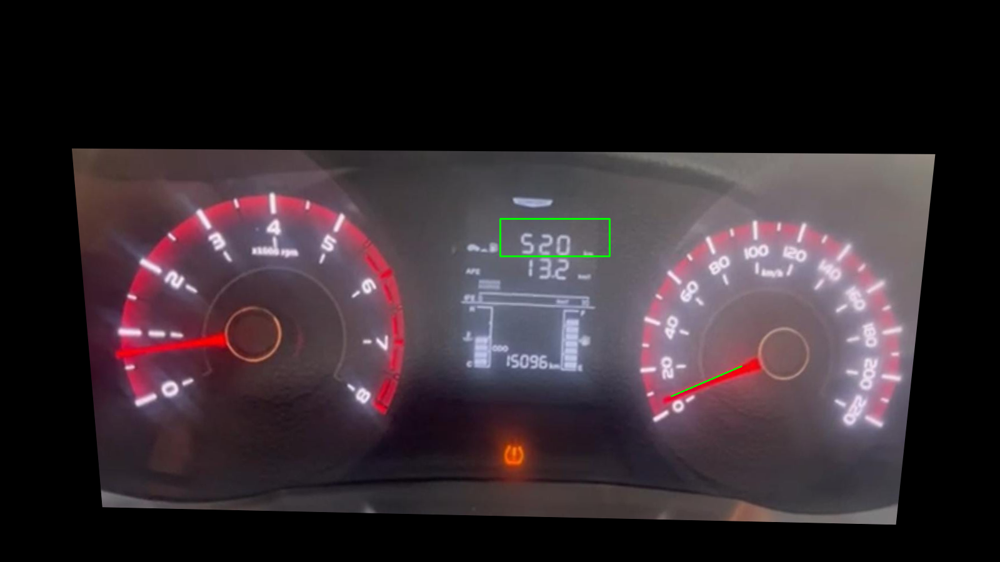

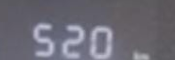

r[0][0] 830 r[0][1] 410


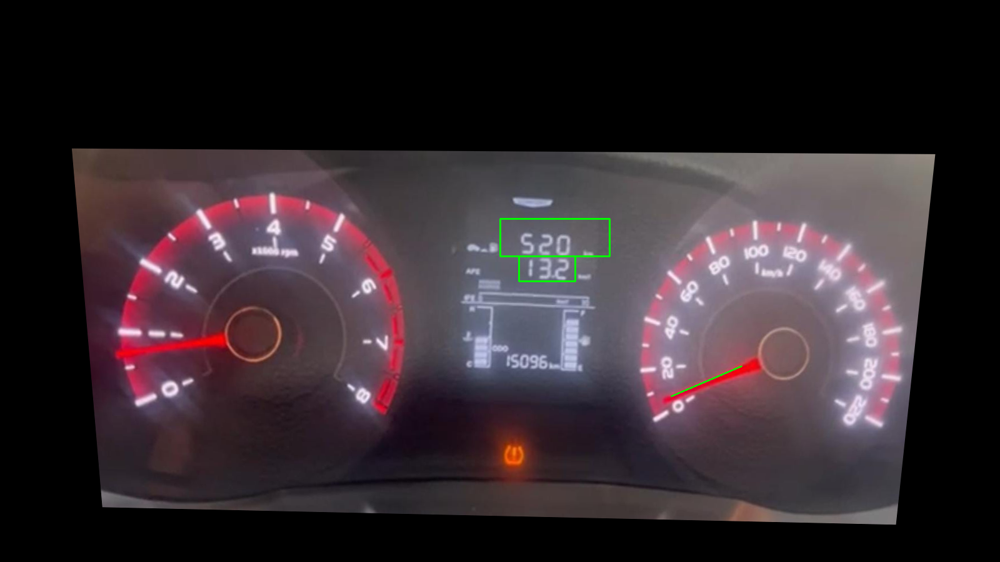

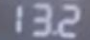

r[0][0] 1000 r[0][1] 350


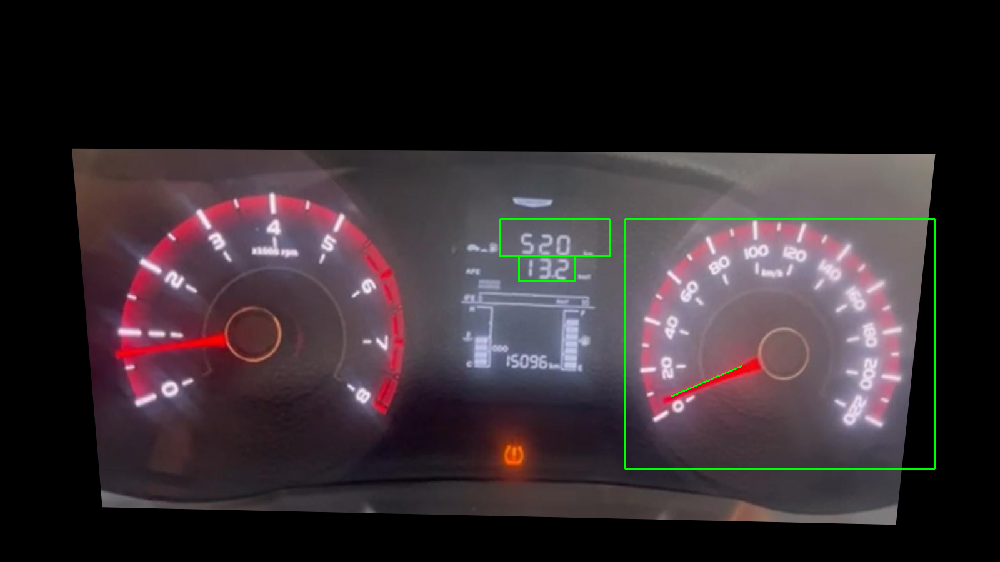

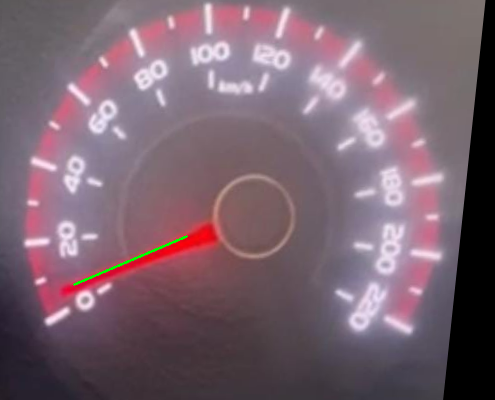

In [ ]:
#  bas roi nikaalne ke lie hai  yeh cell

roi = [[(800, 350), (975, 410), 'text', 'Distance Travelled'],
       [(830, 410), (920, 450), 'text', 'Average fuel Economy'] ,
        [(1000 , 350) , (1495,750), 'Dial', 'Speedometer'] ]



# cv2_imshow(imgScan)
imgShow = imgScan.copy()
imgMask = np.zeros_like(imgShow)

# Visualize the mask (should be black initially)
# cv2_imshow(imgMask)
print(imgMask.shape)

for x, r in enumerate(roi):
    print("r[0][0]", r[0][0], "r[0][1]", r[0][1])

    # Draw the rectangle in green (this is the bounding box)
    cv2.rectangle(imgShow, (r[0][0], r[0][1]), (r[1][0], r[1][1]), (0, 255, 0), 2)

    # Show the image with the bounding box
    cv2_imshow(imgShow)

    # Crop the region for further analysis
    imgCrop = imgScan[r[0][1]:r[1][1], r[0][0]:r[1][0]]
    # print("Printing the cropped ROI image")
    # height, width = imgScan.shape[:2]
    # roi_x1, roi_y1 = r[0]
    # roi_x2, roi_y2 = r[1]

    # # Check if the coordinates are within image bounds
    # if roi_x1 < 0 or roi_y1 < 0 or roi_x2 > width or roi_y2 > height:
    #     print(f"Invalid ROI coordinates: {r[0]} to {r[1]} in image {y}.")
    # else:
    #     imgCrop = imgScan[roi_y1:roi_y2, roi_x1:roi_x2]
    #     if imgCrop.size == 0:
    #         print(f"Error: Cropped image is empty for ROI {r[3]} in image {y}.")
    #     else:
    #         print("Printing the cropped ROI image")
    #         cv2_imshow(imgCrop)

    cv2_imshow(imgCrop)
